<a href="https://colab.research.google.com/github/CristianoDataScience/Analise-Estat-stica-Enem_2019/blob/main/Medidas_posicao_dispersao.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

## Medidas de dispersão e de posição

In [ ]:
import pandas as pd
import numpy as np
# bibliotecas para trabalhar offline com a biblioteca
import plotly 
import plotly.offline as py
import plotly.graph_objs as go # criará de fato os gráficos
from plotly.offline import plot, iplot
import cufflinks as cf # para conectar o plotly ao pandas
cf.go_offline()
plotly.offline.init_notebook_mode(connected = False)

In [ ]:
import plotly.io as pio
pio.renderers

Renderers configuration
-----------------------
    Default renderer: 'plotly_mimetype+notebook'
    Available renderers:
        ['plotly_mimetype', 'jupyterlab', 'nteract', 'vscode',
         'notebook', 'notebook_connected', 'kaggle', 'azure', 'colab',
         'cocalc', 'databricks', 'json', 'png', 'jpeg', 'jpg', 'svg',
         'pdf', 'browser', 'firefox', 'chrome', 'chromium', 'iframe',
         'iframe_connected', 'sphinx_gallery', 'sphinx_gallery_png']

In [ ]:
pio.renderers.default = 'colab'

In [ ]:
enem_sp = pd.read_csv('/content/drive/MyDrive/curso estatistica/enem_2019_tratado.csv', sep=',', encoding='iso-8859-1')

In [ ]:
enem_sp.head()

,NU_INSCRICAO,NO_MUNICIPIO_RESIDENCIA,IDADE,SEXO,TP_ESTADO_CIVIL,RACA,TP_NACIONALIDADE,TP_ST_CONCLUSAO,ESCOLA,CO_ESCOLA,...,NOTA_MT,TP_LINGUA,TP_STATUS_REDACAO,COMP1,COMP2,COMP3,COMP4,COMP5,NOTA_REDACAO,INTERNET
0,"1,90E+11",Santa Isabel,22,M,1,parda,1,1,nao_respondeu,NaN,...,600.2,Ingles,1.0,160.0,200.0,180.0,200.0,200.0,940.0,Sim
1,"1,90E+11",São Paulo,17,F,1,parda,1,2,privada,15567761.0,...,731.8,Ingles,1.0,160.0,120.0,200.0,200.0,200.0,880.0,Nao
2,"1,90E+11",São Bernardo do Campo,19,M,1,parda,1,2,publica,35904958.0,...,393.2,Espanhol,1.0,80.0,160.0,120.0,100.0,100.0,560.0,Sim
3,"1,90E+11",Embu-Guaçu,17,F,1,parda,1,2,publica,NaN,...,419.2,Ingles,1.0,120.0,120.0,120.0,120.0,80.0,560.0,Sim
4,"1,90E+11",Guarulhos,23,F,1,branca,1,1,nao_respondeu,NaN,...,796.1,Ingles,1.0,160.0,200.0,180.0,180.0,160.0,880.0,Sim


## Medidas de dispersão

In [ ]:
enem_sp['NOTA_MT'].var() # Variância

33659.47050441148

In [ ]:
enem_sp['NOTA_MT'].std() # Desvio padrão

183.46517518158993

In [ ]:
enem_sp['NOTA_MT'].mean() # Média

497.5942403088371

In [ ]:
enem_sp['NOTA_MT'].mad() # Desvio absoluto

132.98102283464956

In [ ]:
enem_sp['NOTA_REDACAO'].var()

29082.774122780305

In [ ]:
enem_sp['NOTA_REDACAO'].std()

170.53672367786447

In [ ]:
enem_sp['NOTA_REDACAO'].mean()

593.0183221986639

In [ ]:
enem_sp.describe()

,IDADE,TP_ESTADO_CIVIL,TP_NACIONALIDADE,TP_ST_CONCLUSAO,CO_ESCOLA,TP_PRESENCA_CN,TP_PRESENCA_CH,TP_PRESENCA_LC,TP_PRESENCA_MT,NOTA_CN,NOTA_CH,NOTA_LC,NOTA_MT,TP_STATUS_REDACAO,COMP1,COMP2,COMP3,COMP4,COMP5,NOTA_REDACAO
count,499940.000000,499940.000000,499940.000000,499940.000000,1.768940e+05,499940.0,499940.0,499940.0,499940.0,499940.000000,499940.000000,499940.000000,499940.000000,499940.000000,499940.000000,499940.000000,499940.000000,499940.000000,499940.000000,499940.000000
mean,20.593387,1.053206,1.029902,1.476085,3.521138e+07,1.0,1.0,1.0,1.0,449.917000,482.228054,491.941262,497.594240,1.072105,125.000760,127.066808,118.760691,124.989359,97.200704,593.018322
std,6.465291,0.380866,0.230986,0.510351,4.430392e+05,0.0,0.0,0.0,0.0,152.982255,161.122963,156.247134,183.465175,0.584314,28.629513,39.846083,36.778882,33.879299,57.787427,170.536724
min,12.000000,0.000000,0.000000,1.000000,1.100306e+07,1.0,1.0,1.0,1.0,0.000000,0.000000,0.000000,0.000000,1.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
25%,17.000000,1.000000,1.000000,1.000000,3.501625e+07,1.0,1.0,1.0,1.0,412.400000,450.600000,490.100000,427.900000,1.000000,120.000000,120.000000,100.000000,120.000000,60.000000,500.000000
50%,18.000000,1.000000,1.000000,1.000000,3.504496e+07,1.0,1.0,1.0,1.0,478.100000,523.700000,538.300000,511.800000,1.000000,120.000000,120.000000,120.000000,120.000000,100.000000,600.000000
75%,21.000000,1.000000,1.000000,2.000000,3.529070e+07,1.0,1.0,1.0,1.0,544.400000,578.100000,576.200000,617.900000,1.000000,140.000000,140.000000,140.000000,140.000000,140.000000,680.000000
max,91.000000,4.000000,4.000000,4.000000,5.300104e+07,1.0,1.0,1.0,1.0,860.900000,822.700000,772.300000,984.700000,9.000000,200.000000,200.000000,200.000000,200.000000,200.000000,1000.000000


## Medidas de Posição

In [ ]:
enem_sp['NOTA_MT'].min() # Mínimo

0.0

In [ ]:
enem_sp['NOTA_MT'].max() # Máximo

984.7

In [ ]:
# Primeiro Quartil
enem_sp['NOTA_MT'].quantile(q=0.25) #25% 

427.9

In [ ]:
# Segundo Quartil (Mediana)
enem_sp['NOTA_MT'].quantile(q=0.5) #50%

511.8

In [ ]:
# Terceiro Quartil
enem_sp['NOTA_MT'].quantile(q=0.75) #75%

617.9

In [ ]:
enem_sp['NOTA_MT'].describe()

count    499940.000000
mean        497.594240
std         183.465175
min           0.000000
25%         427.900000
50%         511.800000
75%         617.900000
max         984.700000
Name: NOTA_MT, dtype: float64

## Gráfico BoxPlot e Outliers

In [ ]:
import matplotlib.pyplot as plt


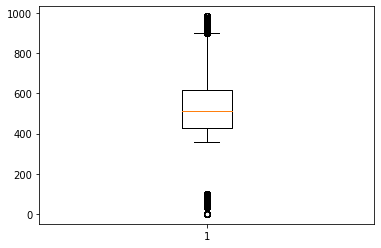

In [ ]:
plt.boxplot(enem_sp.NOTA_MT)
plt.show()

## Seaborn

In [ ]:
import seaborn as sns

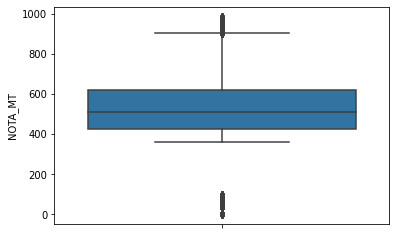

In [ ]:
sns.boxplot(y='NOTA_MT', data=enem_sp);

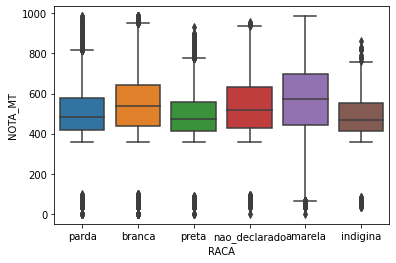

In [104]:
sns.boxplot(x='RACA', y='NOTA_MT', data=enem_sp);

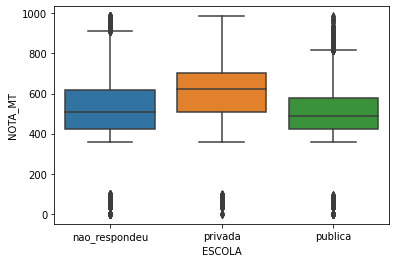

In [105]:
sns.boxplot(x='ESCOLA', y='NOTA_MT', data=enem_sp);

## Plotly

In [ ]:
import plotly.express as px

In [ ]:
grafico = px.box(enem_sp, y='NOTA_MT')
grafico.show()

In [ ]:
sem_outliers = enem_sp.loc[enem_sp.NOTA_MT <= 902.9]
sem_outliers

,NU_INSCRICAO,NO_MUNICIPIO_RESIDENCIA,IDADE,SEXO,TP_ESTADO_CIVIL,RACA,TP_NACIONALIDADE,TP_ST_CONCLUSAO,ESCOLA,CO_ESCOLA,...,NOTA_MT,TP_LINGUA,TP_STATUS_REDACAO,COMP1,COMP2,COMP3,COMP4,COMP5,NOTA_REDACAO,INTERNET
0,"1,90E+11",Santa Isabel,22,M,1,parda,1,1,nao_respondeu,NaN,...,600.2,Ingles,1.0,160.0,200.0,180.0,200.0,200.0,940.0,Sim
1,"1,90E+11",São Paulo,17,F,1,parda,1,2,privada,15567761.0,...,731.8,Ingles,1.0,160.0,120.0,200.0,200.0,200.0,880.0,Nao
2,"1,90E+11",São Bernardo do Campo,19,M,1,parda,1,2,publica,35904958.0,...,393.2,Espanhol,1.0,80.0,160.0,120.0,100.0,100.0,560.0,Sim
3,"1,90E+11",Embu-Guaçu,17,F,1,parda,1,2,publica,NaN,...,419.2,Ingles,1.0,120.0,120.0,120.0,120.0,80.0,560.0,Sim
4,"1,90E+11",Guarulhos,23,F,1,branca,1,1,nao_respondeu,NaN,...,796.1,Ingles,1.0,160.0,200.0,180.0,180.0,160.0,880.0,Sim
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
499935,"1,90E+11",São Paulo,18,F,1,parda,1,1,nao_respondeu,NaN,...,479.1,Espanhol,1.0,100.0,120.0,120.0,140.0,100.0,580.0,Sim
499936,"1,90E+11",São Paulo,17,F,1,preta,1,2,publica,35925457.0,...,43.2,Espanhol,1.0,80.0,120.0,140.0,120.0,100.0,560.0,Sim
499937,"1,90E+11",São Paulo,17,F,1,parda,1,2,publica,35001156.0,...,487.3,Ingles,1.0,120.0,80.0,60.0,120.0,0.0,380.0,Sim
499938,"1,90E+11",São Paulo,17,M,1,parda,1,2,publica,NaN,...,401.1,Ingles,1.0,160.0,120.0,160.0,140.0,160.0,740.0,Nao


In [ ]:
sem_outliers = sem_outliers.loc[sem_outliers.NOTA_MT >= 359.1]
sem_outliers

,NU_INSCRICAO,NO_MUNICIPIO_RESIDENCIA,IDADE,SEXO,TP_ESTADO_CIVIL,RACA,TP_NACIONALIDADE,TP_ST_CONCLUSAO,ESCOLA,CO_ESCOLA,...,NOTA_MT,TP_LINGUA,TP_STATUS_REDACAO,COMP1,COMP2,COMP3,COMP4,COMP5,NOTA_REDACAO,INTERNET
0,"1,90E+11",Santa Isabel,22,M,1,parda,1,1,nao_respondeu,NaN,...,600.2,Ingles,1.0,160.0,200.0,180.0,200.0,200.0,940.0,Sim
1,"1,90E+11",São Paulo,17,F,1,parda,1,2,privada,15567761.0,...,731.8,Ingles,1.0,160.0,120.0,200.0,200.0,200.0,880.0,Nao
2,"1,90E+11",São Bernardo do Campo,19,M,1,parda,1,2,publica,35904958.0,...,393.2,Espanhol,1.0,80.0,160.0,120.0,100.0,100.0,560.0,Sim
3,"1,90E+11",Embu-Guaçu,17,F,1,parda,1,2,publica,NaN,...,419.2,Ingles,1.0,120.0,120.0,120.0,120.0,80.0,560.0,Sim
4,"1,90E+11",Guarulhos,23,F,1,branca,1,1,nao_respondeu,NaN,...,796.1,Ingles,1.0,160.0,200.0,180.0,180.0,160.0,880.0,Sim
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
499934,"1,90E+11",São Paulo,20,F,1,parda,1,1,nao_respondeu,NaN,...,514.8,Espanhol,1.0,100.0,120.0,120.0,140.0,140.0,620.0,Sim
499935,"1,90E+11",São Paulo,18,F,1,parda,1,1,nao_respondeu,NaN,...,479.1,Espanhol,1.0,100.0,120.0,120.0,140.0,100.0,580.0,Sim
499937,"1,90E+11",São Paulo,17,F,1,parda,1,2,publica,35001156.0,...,487.3,Ingles,1.0,120.0,80.0,60.0,120.0,0.0,380.0,Sim
499938,"1,90E+11",São Paulo,17,M,1,parda,1,2,publica,NaN,...,401.1,Ingles,1.0,160.0,120.0,160.0,140.0,160.0,740.0,Nao


In [ ]:
sem_outliers.head()

,NU_INSCRICAO,NO_MUNICIPIO_RESIDENCIA,IDADE,SEXO,TP_ESTADO_CIVIL,RACA,TP_NACIONALIDADE,TP_ST_CONCLUSAO,ESCOLA,CO_ESCOLA,...,NOTA_MT,TP_LINGUA,TP_STATUS_REDACAO,COMP1,COMP2,COMP3,COMP4,COMP5,NOTA_REDACAO,INTERNET
0,"1,90E+11",Santa Isabel,22,M,1,parda,1,1,nao_respondeu,NaN,...,600.2,Ingles,1.0,160.0,200.0,180.0,200.0,200.0,940.0,Sim
1,"1,90E+11",São Paulo,17,F,1,parda,1,2,privada,15567761.0,...,731.8,Ingles,1.0,160.0,120.0,200.0,200.0,200.0,880.0,Nao
2,"1,90E+11",São Bernardo do Campo,19,M,1,parda,1,2,publica,35904958.0,...,393.2,Espanhol,1.0,80.0,160.0,120.0,100.0,100.0,560.0,Sim
3,"1,90E+11",Embu-Guaçu,17,F,1,parda,1,2,publica,NaN,...,419.2,Ingles,1.0,120.0,120.0,120.0,120.0,80.0,560.0,Sim
4,"1,90E+11",Guarulhos,23,F,1,branca,1,1,nao_respondeu,NaN,...,796.1,Ingles,1.0,160.0,200.0,180.0,180.0,160.0,880.0,Sim


In [ ]:
grafico = px.box(sem_outliers, y='NOTA_MT')
grafico.show()

In [ ]:
grafico = px.box(enem_sp, y='NOTA_CN')
grafico.show()

In [ ]:
grafico = px.box(enem_sp, y='NOTA_LC')
grafico.show()

In [ ]:
grafico = px.box(enem_sp, y='NOTA_REDACAO')
grafico.show()

In [ ]:
grafico = px.box(enem_sp, x='SEXO', y='NOTA_MT')
grafico.show()

In [ ]:
grafico = px.box(enem_sp, x='RACA', y='NOTA_MT')
grafico.show()

In [ ]:
grafico = px.box(enem_sp, x='ESCOLA', y='NOTA_MT')
grafico.show()